<a href="https://colab.research.google.com/github/pabanib/covid/blob/main/datos_covid.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Instalación

In [3]:
! pip install geopandas
! pip install pysal 
! pip install cartoframes 
! pip install --user urllib3==1.22
! pip install --user urllib3==1.24
! pip install mapclassify

     |████████████████████████████████| 1.0MB 13.8MB/s 
     |████████████████████████████████| 6.6MB 39.7MB/s 
     |████████████████████████████████| 15.4MB 275kB/s 
     |████████████████████████████████| 2.4MB 19.5MB/s 
     |████████████████████████████████| 112kB 32.0MB/s 
     |████████████████████████████████| 61kB 7.0MB/s 
     |████████████████████████████████| 61kB 7.7MB/s 
     |████████████████████████████████| 92kB 10.4MB/s 
     |████████████████████████████████| 51kB 6.7MB/s 
     |████████████████████████████████| 51kB 6.7MB/s 
     |████████████████████████████████| 215kB 38.4MB/s 
     |████████████████████████████████| 5.7MB 39.1MB/s 
     |████████████████████████████████| 61kB 8.3MB/s 
     |████████████████████████████████| 143kB 45.9MB/s 
     |████████████████████████████████| 235kB 44.0MB/s 
     |████████████████████████████████| 235kB 30.6MB/s 
     |████████████████████████████████| 57.4MB 63kB/s 
     |████████████████████████████████| 1.0MB 37.8MB/s 
    

     |████████████████████████████████| 245kB 13.7MB/s 
     |████████████████████████████████| 245kB 19.9MB/s 
     |████████████████████████████████| 133kB 29.4MB/s 
  Created wheel for pyrestcli: filename=pyrestcli-0.6.11-cp37-none-any.whl size=8499 sha256=78d94e63d43727f0db5b5a47cdc2350681f00e690f4345946937ebc54f92adf0
  Stored in directory: /root/.cache/pip/wheels/2f/bb/11/396a62e2d1e718f2bfb02b66726240fbc8d98640bfc0cf1688
Successfully built pyrestcli
ERROR: pysal 2.4.0 has requirement urllib3>=1.26, but you'll have urllib3 1.25.11 which is incompatible.
ERROR: datascience 0.10.6 has requirement folium==0.2.1, but you'll have folium 0.8.3 which is incompatible.
  Found existing installation: urllib3 1.26.5
    Uninstalling urllib3-1.26.5:
      Successfully uninstalled urllib3-1.26.5
     |████████████████████████████████| 133kB 14.0MB/s 
ERROR: pysal 2.4.0 has requirement urllib3>=1.26, but you'll have urllib3 1.22 which is incompatible.
ERROR: datascience 0.10.6 has requirement 

# Lectura de datos

In [1]:
! wget https://sisa.msal.gov.ar/datos/descargas/covid-19/files/Covid19Casos.zip
! unzip Covid19Casos.zip
! wget https://www.indec.gob.ar/ftp/cuadros/territorio/codgeo/Codgeo_Pais_x_dpto_con_datos.zip
! unzip Codgeo_Pais_x_dpto_con_datos.zip


"wget" no se reconoce como un comando interno o externo,
programa o archivo por lotes ejecutable.
unzip:  cannot find or open Covid19Casos.zip, Covid19Casos.zip.zip or Covid19Casos.zip.ZIP.
"wget" no se reconoce como un comando interno o externo,
programa o archivo por lotes ejecutable.
unzip:  cannot find or open Codgeo_Pais_x_dpto_con_datos.zip, Codgeo_Pais_x_dpto_con_datos.zip.zip or Codgeo_Pais_x_dpto_con_datos.zip.ZIP.


In [1]:
import sys
#from google.colab import drive
#drive.mount("/content/drive/")
#sys.path.append("/content/drive/MyDrive/Tesis/covid/covid/")
import preproceso as pre

In [2]:
import numpy as np
import pandas as pd
import geopandas as gpd 
import matplotlib.pyplot as plt

In [3]:
#local 
Arg = gpd.read_file('shape_files/pxdptodatosok.shp')
#Arg = gpd.read_file('pxdptodatosok.shp')

<AxesSubplot:>

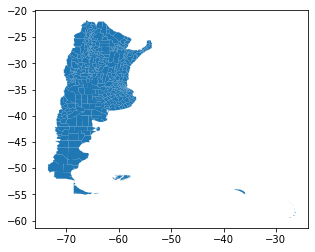

In [4]:
Arg = Arg.drop(Arg.query("link == '94028'").index, axis = 0)
Arg.plot()

In [5]:
Arg['link'] = Arg['link'].astype(int)
Arg.head()

,link,codpcia,departamen,provincia,mujeres,varones,personas,hogares,viv_part,viv_part_h,geometry
0,2001,02,Comuna 1,Ciudad AutÃ³noma de Buenos Aires,107789,98097,205886,84468,130771,78360,"POLYGON ((-58.37501 -34.57959, -58.36690 -34.5..."
1,2002,02,Comuna 2,Ciudad AutÃ³noma de Buenos Aires,89890,68042,157932,73156,107967,70869,"POLYGON ((-58.40084 -34.57126, -58.40005 -34.5..."
2,2003,02,Comuna 3,Ciudad AutÃ³noma de Buenos Aires,101936,85601,187537,80489,101161,75605,"POLYGON ((-58.39365 -34.60154, -58.39348 -34.6..."
3,2004,02,Comuna 4,Ciudad AutÃ³noma de Buenos Aires,115079,103166,218245,76455,82926,69680,"POLYGON ((-58.35695 -34.61980, -58.35672 -34.6..."
4,6091,06,Berazategui,Buenos Aires,165636,158608,324244,93164,96025,86248,"POLYGON ((-58.01702 -34.78120, -58.08380 -34.8..."


In [6]:
# local 
covid = pd.read_csv('datos/covid.csv')
#covid = pd.read_csv('Covid19Casos.csv')
covid.head()
gen_datos = pre.preparar_datos(covid)
del(covid)

,id_evento_caso,sexo,edad,edad_años_meses,residencia_pais_nombre,residencia_provincia_nombre,residencia_departamento_nombre,carga_provincia_nombre,fecha_inicio_sintomas,fecha_apertura,...,asistencia_respiratoria_mecanica,carga_provincia_id,origen_financiamiento,clasificacion,clasificacion_resumen,residencia_provincia_id,fecha_diagnostico,residencia_departamento_id,ultima_actualizacion,residencia_dpto
0,1000000,M,54.0,Años,Argentina,CABA,SIN ESPECIFICAR,Buenos Aires,NaN,2020-06-01,...,NO,6,Privado,Caso Descartado,Descartado,2,2020-06-09,0,2021-06-04,2000
1,10000000,F,52.0,Años,Argentina,CABA,SIN ESPECIFICAR,CABA,NaN,2021-04-08,...,NO,2,Público,Caso Descartado,Descartado,2,2021-04-08,0,2021-06-04,2000
2,10000001,F,22.0,Años,Argentina,Buenos Aires,Lomas de Zamora,Buenos Aires,2021-04-05,2021-04-08,...,NO,6,Público,Caso Descartado,Descartado,6,2021-04-08,490,2021-06-04,6490
3,10000003,F,33.0,Años,Argentina,CABA,COMUNA 01,CABA,NaN,2021-04-08,...,NO,2,Público,Caso Descartado,Descartado,2,2021-04-08,1,2021-06-04,2001
4,10000005,F,38.0,Años,Argentina,CABA,COMUNA 12,CABA,NaN,2021-04-08,...,NO,2,Público,Caso Descartado,Descartado,2,2021-04-06,12,2021-06-04,2012


In [14]:

covid_geo = gen_datos.fit()
covid_geo.dtypes

id_evento_caso                                   int64
sexo                                            object
edad                                           float64
edad_años_meses                                 object
residencia_pais_nombre                          object
residencia_provincia_nombre                     object
residencia_departamento_nombre                  object
carga_provincia_nombre                          object
fecha_inicio_sintomas                   datetime64[ns]
fecha_apertura                          datetime64[ns]
sepi_apertura                                    int64
fecha_internacion                       datetime64[ns]
cuidado_intensivo                                 bool
fecha_cui_intensivo                     datetime64[ns]
fallecido                                         bool
fecha_fallecimiento                     datetime64[ns]
asistencia_respiratoria_mecanica                  bool
carga_provincia_id                               int64
origen_fin

In [15]:
campos_desc = ['edad_años_meses', 'residencia_pais_nombre','residencia_provincia_nombre','residencia_departamento_nombre',
               'carga_provincia_nombre','sepi_apertura','carga_provincia_id','origen_financiamiento','clasificacion',
               'clasificacion_resumen','residencia_provincia_id','residencia_departamento_id','ultima_actualizacion']
covid_geo = covid_geo.drop(campos_desc, axis = 1)


In [16]:
claves = ['residencia_dpto','fecha_apertura']
atributos = ['clasificacion_resumen_Confirmado','fallecido']
#atributos = ['clasificacion_resumen_Confirmado','fallecido','origen_financiamiento_Privado','sexo_M','origen_financiamiento_Público',
#              'adulto_medio', 'adulto_mayor','cuidado_intensivo','asistencia_respiratoria_mecanica']
covid_geo.columns

Index(['id_evento_caso', 'sexo', 'edad', 'fecha_inicio_sintomas',
       'fecha_apertura', 'fecha_internacion', 'cuidado_intensivo',
       'fecha_cui_intensivo', 'fallecido', 'fecha_fallecimiento',
       'asistencia_respiratoria_mecanica', 'fecha_diagnostico',
       'residencia_dpto', 'sexo_F', 'sexo_M', 'sexo_NR',
       'origen_financiamiento_Privado', 'origen_financiamiento_Público',
       'clasificacion_resumen_Confirmado', 'clasificacion_resumen_Descartado',
       'clasificacion_resumen_Sin Clasificar',
       'clasificacion_resumen_Sospechoso', 'menores', 'adulto_joven',
       'adulto_medio', 'adulto_mayor'],
      dtype='object')

In [17]:
round(sys.getsizeof(covid_geo[atributos])/(1024**2)), sys.getsizeof(Arg)/(1024**2)

(21, 0.2983274459838867)

# Separación por periodos 

In [18]:
# Agrupamos los datos por localidad y periodo de tiempo
agrupa = covid_geo.groupby(['residencia_dpto',covid_geo.fecha_apertura.dt.month]) 
agrupa_w = covid_geo.groupby(['residencia_dpto',covid_geo.fecha_apertura.dt.week]) 
covid_geo = agrupa[atributos].sum()
covid_geo.head()

C:\Users\paban\anaconda3\envs\py37\lib\site-packages\ipykernel_launcher.py:3: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated.  Please use Series.dt.isocalendar().week instead.
  This is separate from the ipykernel package so we can avoid doing imports until


clasificacion_resumen_Confirmado  fallecido
residencia_dpto fecha_apertura                                             
2000            1                                        16225.0        341
                2                                         9923.0        279
                3                                        14950.0        417
                4                                        30238.0        864
                5                                        27533.0        647

In [19]:
index = covid_geo.index
idx = pd.IndexSlice

covid_periodos = {}

for i in index.get_level_values(1):
    dic = {}
    df = pd.merge(covid_geo.loc[idx[:,i],:], Arg,how= 'inner' ,left_on= 'residencia_dpto', right_on = 'link')
    dic['df'] = gpd.GeoDataFrame(df)
    covid_periodos[i] = dic
    del(dic)

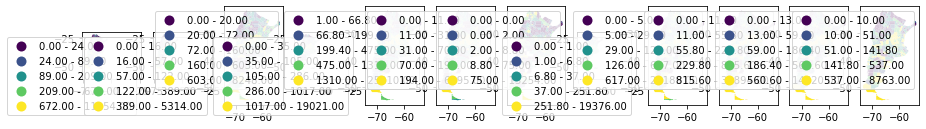

In [24]:
#del(covid_periodos[1990]) #¿Por qué hay 1990? revisar
largo = len(covid_periodos.keys())
fig, ax = plt.subplots(1,largo,figsize = (15,10))
j = 0
for key in covid_periodos.keys():
    covid_periodos[key]['df'].plot(column = 'clasificacion_resumen_Confirmado', ax = ax[j], scheme = 'Quantiles',k = 5,legend = True, figsize = (15,15))
    j +=1
#covid_geo2021.plot(column = 'clasificacion_resumen_Confirmado', ax = ax[1], scheme = 'Quantiles',k = 5,legend = True, figsize = (15,15))

# Clustering 

## Kmeans

In [1]:
import pysal as ps 
from sklearn.cluster import KMeans, AgglomerativeClustering

C:\Users\paban\anaconda3\envs\py37\lib\site-packages\pysal\explore\segregation\network\network.py:16: UserWarning: You need pandana and urbanaccess to work with segregation's network module
You can install them with  `pip install urbanaccess pandana` or `conda install -c udst pandana urbanaccess`
  "You need pandana and urbanaccess to work with segregation's network module\n"
C:\Users\paban\anaconda3\envs\py37\lib\site-packages\pysal\model\spvcm\abstracts.py:10: UserWarning: The `dill` module is required to use the sqlite backend fully.
  from .sqlite import head_to_sql, start_sql


In [42]:
#atributos = ['clasificacion_resumen_Confirmado','fallecido','origen_financiamiento_Privado','sexo_M','varones','personas','hogares']
atributos.append('personas')
from sklearn.pipeline import Pipeline
from sklearn import preprocessing
pipeline = Pipeline(
    [('escalado', preprocessing.StandardScaler())]
)

#escalado = preprocessing.StandardScaler().fit(covid_geo[atributos])
#covid_escalado = escalado.transform(covid_geo[atributos])
#covid_geo[atributos] = covid_geo[atributos].astype(float)
def kmeans_func(df, k):
    covid_escalado = pipeline.fit_transform(df)
    kmeans = KMeans(n_clusters = k)
    np.random.seed(91)
    grupos = kmeans.fit(covid_escalado)
    return grupos

for k in covid_periodos.keys():
    df = covid_periodos[k]['df'][atributos]
    df = pipeline.fit_transform(df)
    grupos = kmeans_func(df,5)
    covid_periodos[k]['kmeans'] = grupos
    covid_periodos[k]['df']['regiones'] = grupos.labels_
#grupos = kmeans_func(pipeline.fit_transform(covid_geo2021[atributos]), 15)

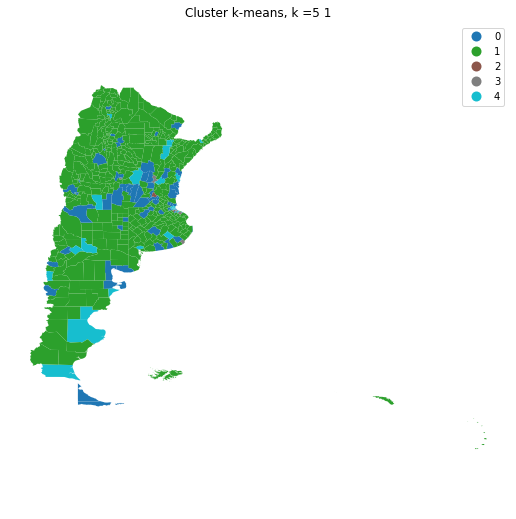

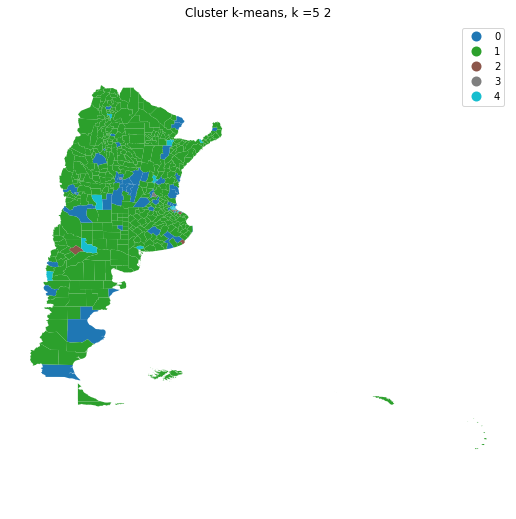

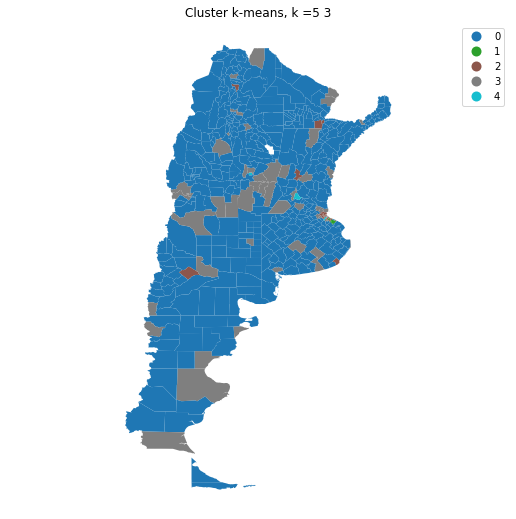

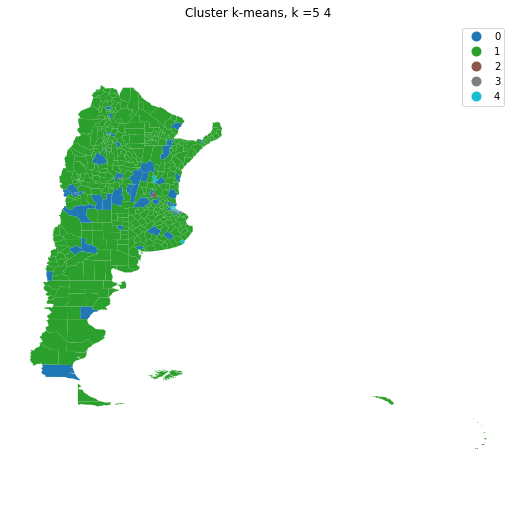

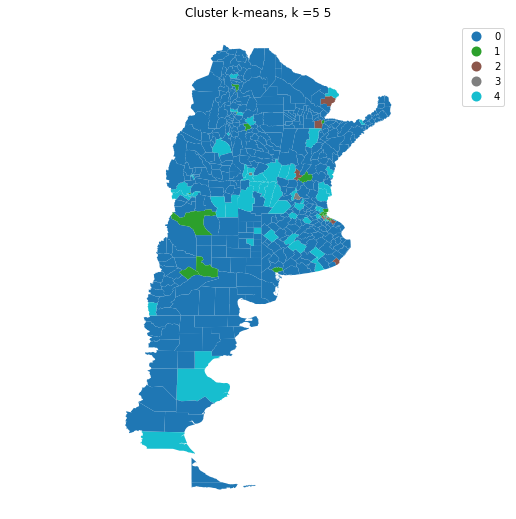

...

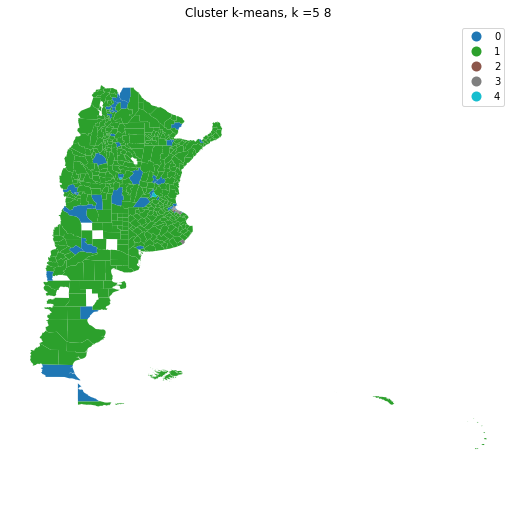

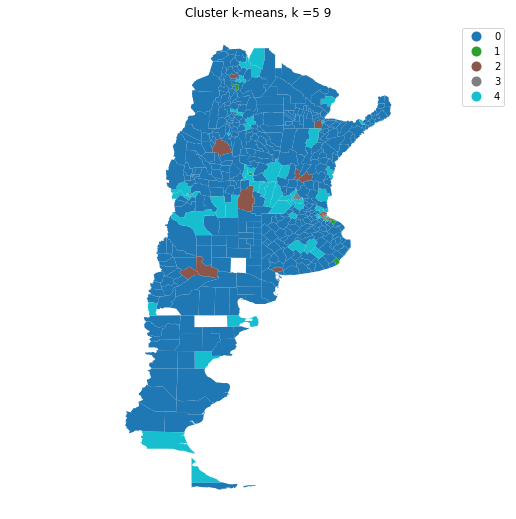

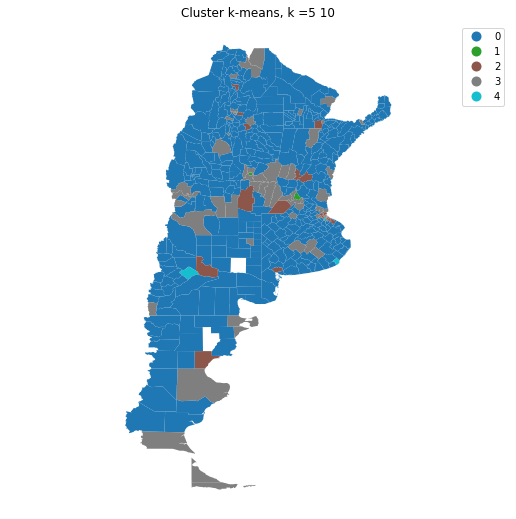

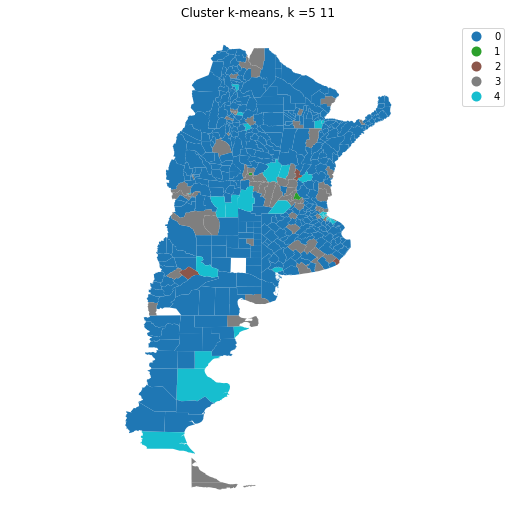

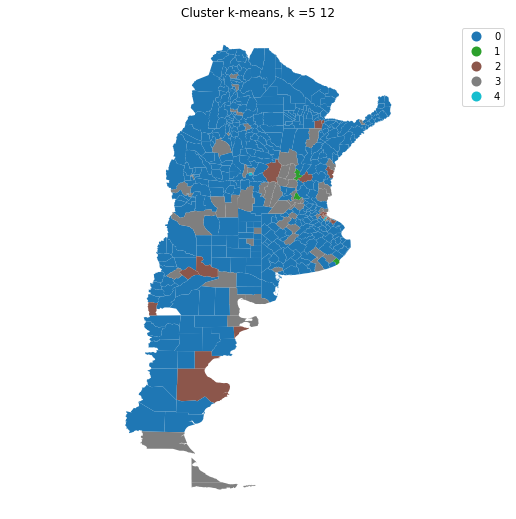

In [43]:
def grafico(df, grupos,columna = 'regiones', titulo = ''):
    f,ax = plt.subplots(1, figsize = (9,9))
    df.plot(column = columna, categorical = True, legend = True, linewidth = 0, ax = ax)
    ax.set_axis_off()
    plt.axis('equal')
    plt.title(titulo)
    plt.show()

for k in covid_periodos.keys():
    df = covid_periodos[k]['df']
    grupos = covid_periodos[k]['kmeans']
    grafico(df, grupos,'regiones' ,'Cluster k-means, k =5 {}'.format(k))

In [45]:
from cartoframes.viz import Layer, color_bins_style, formula_widget, category_widget, histogram_widget, popup_element

año = 6 

Layer(covid_periodos[año]['df'],
      #encode_data = False,
      color_bins_style('regiones', method = 'equal', breaks= range(5), palette = 'mint'),
      encode_data = False,
      widgets=[
          formula_widget('clasificacion_resumen_Confirmado','Sum','Casos COVID'),
          formula_widget('fallecido','Sum','Fallecidos'),
          
          histogram_widget('fallecido')
      ]
    
)

In [46]:
from ipywidgets import interact

año = 6

def plot_function(n = 6):
    cov = covid_periodos[año]['df'].groupby('regiones').sum()[atributos]
    columna = atributos[n]
    f, ax = plt.subplots()
    cov[columna].plot(kind = 'bar',ax = ax)
    #plt.axis('equal')
    plt.title(columna)
    plt.show()
   
interact(plot_function, n = (0,6,1))

interactive(children=(IntSlider(value=6, description='n', max=6), Output()), _dom_classes=('widget-interact',)…

<function __main__.plot_function(n=6)>

In [47]:
covid_periodos[año]['df'].groupby('regiones').sum()

,clasificacion_resumen_Confirmado,fallecido,link
regiones,,,
0,42875.0,1175,778880
1,36850.0,502,18144348
2,6495.0,249,6427
3,9053.0,11,96098
4,18308.0,840,50731


In [48]:
def ss(df):
    medias = df.mean(axis = 0)
    ssd = []
    for i in range(df.shape[1]):
        var = df[:,i]-medias[i]
        var2 = var**2
        ssd.append(sum(var2))
    ssd = np.array(ssd)
    return  sum(ssd)

def SSD(DF, columna, atrib):
    df = DF[atributos] 
    TSS = ss(pipeline.fit_transform(df))
    WSS = []
    for i in DF[columna].unique():
        d = df[DF[columna] == i]
        d = pipeline.fit_transform(d)
        s = ss(d)
        WSS.append(s)
    WSS = np.sum(np.array(WSS))
    BSS = TSS-WSS
    RBTSS = BSS/TSS
    return {'TSS': TSS, 'WSS': WSS, 'BSS': BSS, 'RBTSS':RBTSS}



In [49]:
for k in covid_periodos.keys():
    df = covid_periodos[k]['df']
    ssd = SSD(df,'regiones', atributos)
    covid_periodos[k]['ssd'] = ssd
    print(ssd)

{'TSS': 1578.0000000000027, 'WSS': 1578.0000000000014, 'BSS': 1.3642420526593924e-12, 'RBTSS': 8.645386898982193e-16}
{'TSS': 1578.000000000004, 'WSS': 1578.0000000000027, 'BSS': 1.3642420526593924e-12, 'RBTSS': 8.645386898982185e-16}
{'TSS': 1572.0000000000005, 'WSS': 1571.9999999999982, 'BSS': 2.2737367544323206e-12, 'RBTSS': 1.446397426483664e-15}
{'TSS': 1577.999999999999, 'WSS': 1577.999999999998, 'BSS': 1.1368683772161603e-12, 'RBTSS': 7.204489082485177e-16}
{'TSS': 1574.9999999999989, 'WSS': 1575.0000000000005, 'BSS': -1.5916157281026244e-12, 'RBTSS': -1.0105496686365877e-15}
{'TSS': 1562.9999999999995, 'WSS': 1559.9999999999948, 'BSS': 3.000000000004775, 'RBTSS': 0.001919385796548161}
{'TSS': 1527.0000000000005, 'WSS': 1523.9999999999957, 'BSS': 3.000000000004775, 'RBTSS': 0.001964636542242812}
{'TSS': 1554.000000000004, 'WSS': 1551.000000000003, 'BSS': 3.000000000001137, 'RBTSS': 0.001930501930502657}
{'TSS': 1562.9999999999955, 'WSS': 1563.000000000001, 'BSS': -5.456968210637

In [51]:
covid_periodos[6]['kmeans'].inertia_

199.25900153825725

## Jerárquico

In [52]:
np.random.seed(45)
for k in covid_periodos.keys():
    df = pipeline.fit_transform(covid_periodos[k]['df'][atributos])
    aglomerativo = AgglomerativeClustering(linkage = 'ward', n_clusters = 20)
    grupos = aglomerativo.fit(df)
    covid_periodos[k]['Aglo'] = grupos
    covid_periodos[k]['df']['reg_aglo'] = grupos.labels_
    

In [53]:
for k in covid_periodos.keys():
    df = covid_periodos[k]['df']
    ssd = SSD(df,'reg_aglo', atributos)
    covid_periodos[k]['ssd_aglo'] = ssd
    print(ssd)

{'TSS': 1578.0000000000027, 'WSS': 1566.0000000000005, 'BSS': 12.000000000002274, 'RBTSS': 0.007604562737644013}
{'TSS': 1578.000000000004, 'WSS': 1566.0000000000014, 'BSS': 12.000000000002728, 'RBTSS': 0.007604562737644295}
{'TSS': 1572.0000000000005, 'WSS': 1554.000000000001, 'BSS': 17.999999999999545, 'RBTSS': 0.01145038167938902}
{'TSS': 1577.999999999999, 'WSS': 1571.9999999999995, 'BSS': 5.999999999999545, 'RBTSS': 0.003802281368821007}
{'TSS': 1574.9999999999989, 'WSS': 1560.000000000001, 'BSS': 14.999999999997954, 'RBTSS': 0.00952380952380823}
{'TSS': 1562.9999999999995, 'WSS': 1544.9999999999973, 'BSS': 18.000000000002274, 'RBTSS': 0.011516314779272091}
{'TSS': 1527.0000000000005, 'WSS': 1514.9999999999989, 'BSS': 12.000000000001592, 'RBTSS': 0.007858546168959783}
{'TSS': 1554.000000000004, 'WSS': 1541.9999999999995, 'BSS': 12.000000000004547, 'RBTSS': 0.007722007722010628}
{'TSS': 1562.9999999999955, 'WSS': 1551.000000000001, 'BSS': 11.999999999994543, 'RBTSS': 0.007677543186

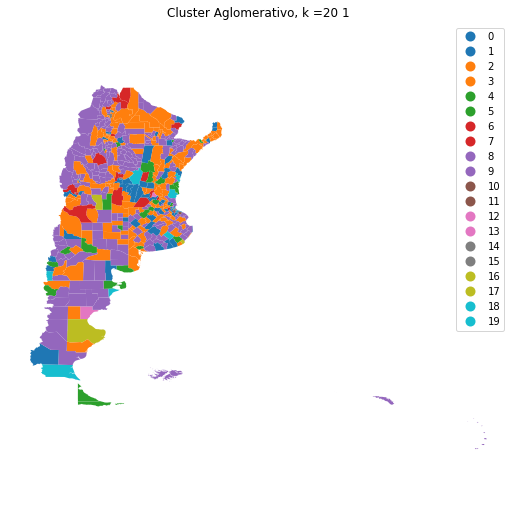

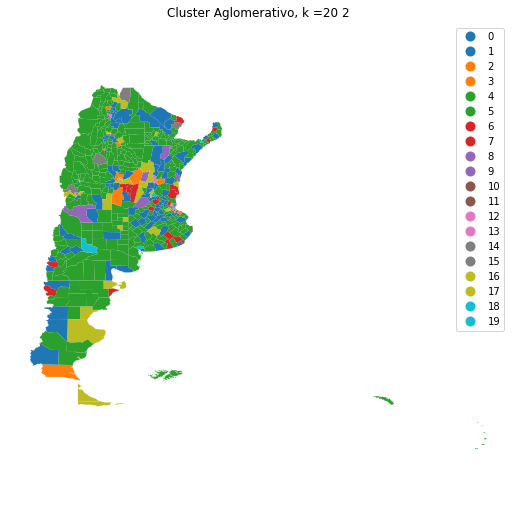

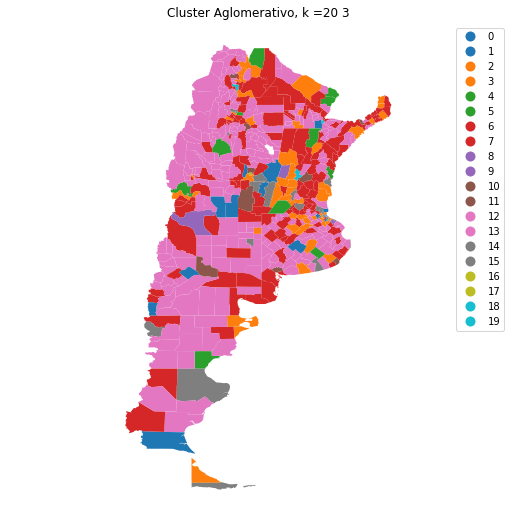

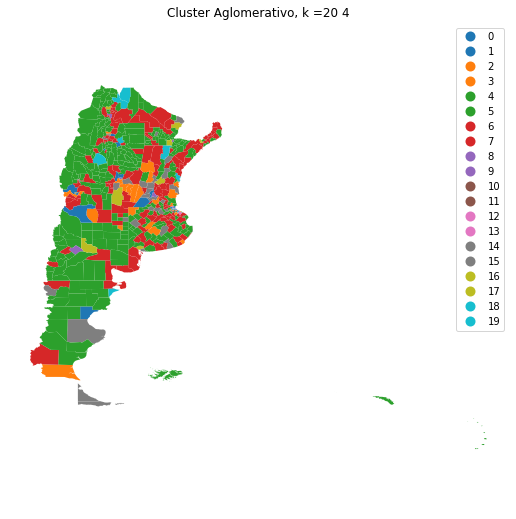

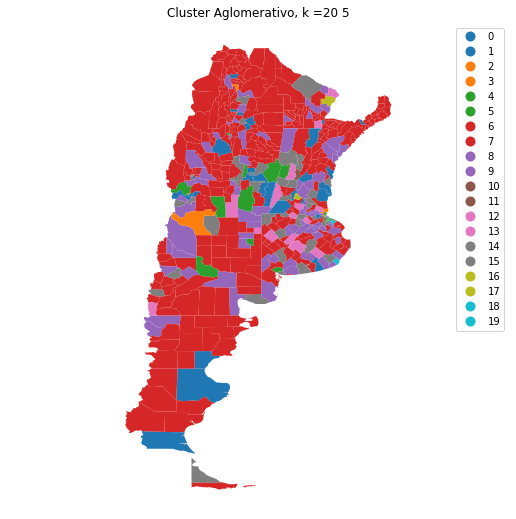

...

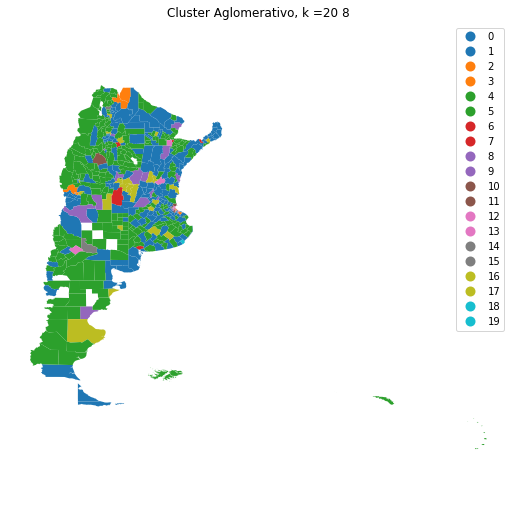

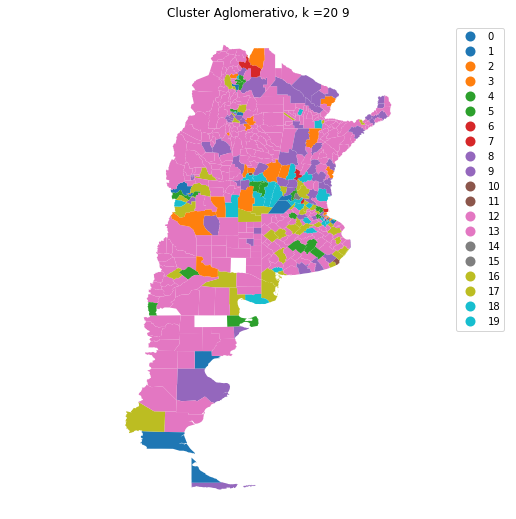

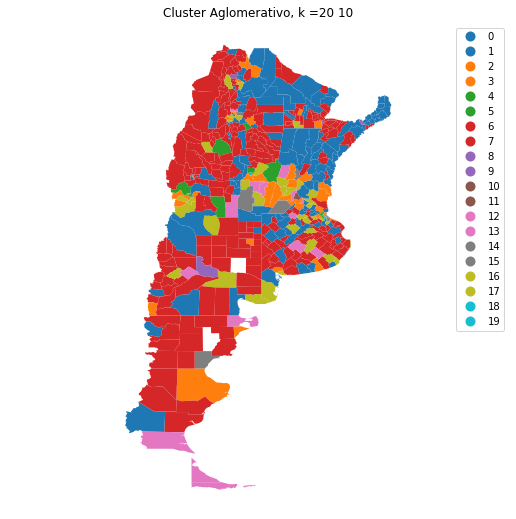

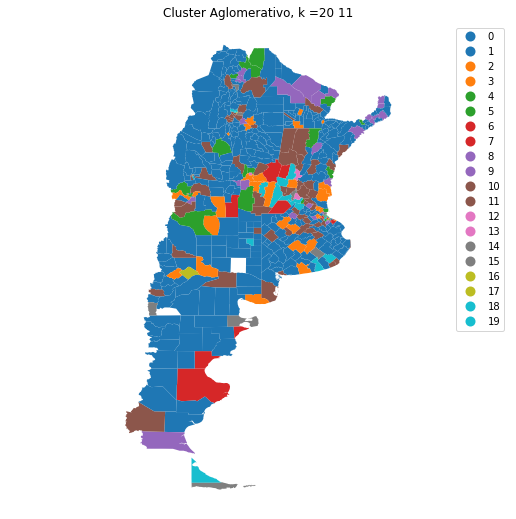

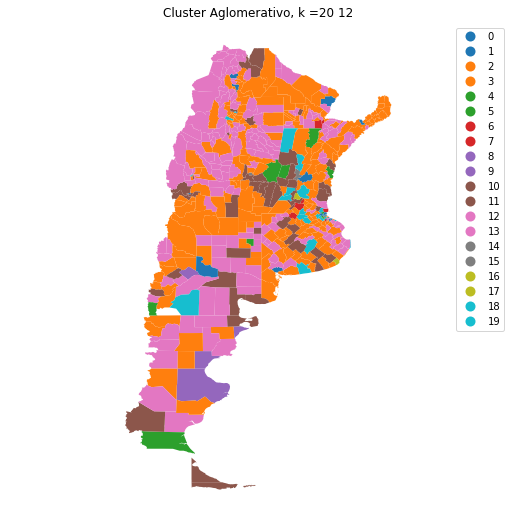

In [54]:
for k in covid_periodos.keys():
    df = covid_periodos[k]['df']
    grupos = covid_periodos[k]['Aglo']
    grafico(df, grupos, 'reg_aglo','Cluster Aglomerativo, k =20 {}'.format(k))

# Restricción espacial

In [55]:
from libpysal.weights import Queen
for k in covid_periodos.keys():
    df = covid_periodos[k]['df']
    w_queen = Queen.from_dataframe(df)
    covid_periodos[k]['w_queen'] = w_queen



C:\Users\paban\anaconda3\envs\py37\lib\site-packages\libpysal\weights\weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 4 disconnected components.
 There is 1 island with id: 525.
  warnings.warn(message)
C:\Users\paban\anaconda3\envs\py37\lib\site-packages\libpysal\weights\weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 3 disconnected components.
  warnings.warn(message)
C:\Users\paban\anaconda3\envs\py37\lib\site-packages\libpysal\weights\weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 4 disconnected components.
 There is 1 island with id: 517.
  warnings.warn(message)


(<Figure size 720x720 with 1 Axes>, <AxesSubplot:>)

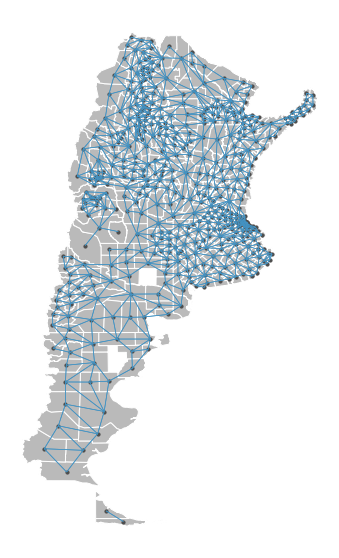

In [59]:
from splot.libpysal import plot_spatial_weights
año = 10

plot_spatial_weights(covid_periodos[10]['w_queen'],covid_periodos[10]['df'])

In [60]:
np.random.seed(456)

for k in covid_periodos.keys():
    df = covid_periodos[k]['df']
    df = pipeline.fit_transform(df[atributos])
    mod_espacial = AgglomerativeClustering(linkage = 'ward',
                                       connectivity = w_queen.sparse,
                                       n_clusters = 20)
    mod_espacial.fit(df)
    grupos = mod_espacial.fit(df)
    covid_periodos[k]['mod_espacial'] = grupos
    covid_periodos[k]['df']['reg_esp'] = grupos.labels_


ValueError: Wrong shape for connectivity matrix: (524, 524) when X is (526, 3)

In [ ]:
for k in covid_periodos.keys():
    df = covid_periodos[k]['df']
    grupos = covid_periodos[k]['mod_espacial']
    grafico(df, grupos, 'reg_esp','Cluster Espacial, k =20 {}'.format(k))

# Coeficientes de localización

In [83]:
import scipy.stats as st
def lq(datos, campo, total):
    ind = datos[campo]/datos[total]
    indg = datos[campo].sum()/datos[total].sum()
    return [ind,indg,ind/indg]

def intervalos(data, campo, total, a = .95):
    indices = lq(data, campo,total) 
    pi = indices[0]
    p = indices[1]
    ni = data[total]
    n = data[total].sum()
    
    var = (pi*(1-pi)/(ni*p**2))+((pi**2)*(1-p)/(n*p**3))+(2*(pi**2)*(1-pi)/(n*p**3))
    sd = np.sqrt(var)
    sd
    np.mean(indices[2])
    sdnorm = st.t.ppf((1+a)/2,2)*sd
    #sdnorm = st.norm.ppf((1+a)/2)*sd
    
    return pd.DataFrame([indices[2]-sdnorm,indices[2]+sdnorm.T,sdnorm,indices[2]]).T     

In [87]:
for k in covid_periodos.keys():
    df = covid_periodos[k]['df']
    df_agrup = df.groupby('reg_esp').sum()
    covid_periodos[k]['lq'] = lq(df_agrup,'fallecido','clasificacion_resumen_Confirmado')[2].sort_values()
    covid_periodos[k]['intervalos'] = intervalos(df_agrup,'fallecido','clasificacion_resumen_Confirmado').round(2)

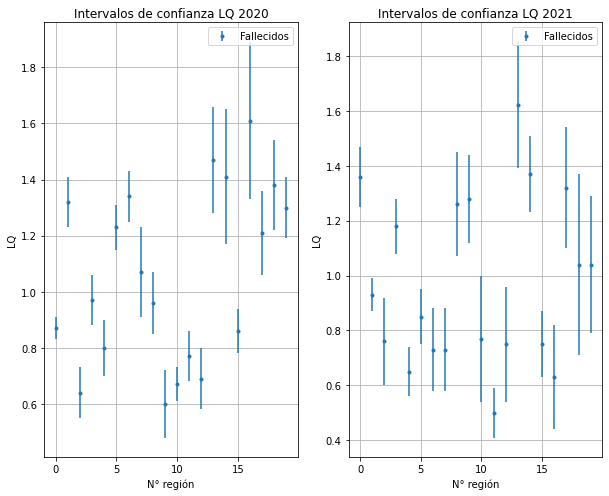

In [91]:
largo = len(covid_periodos.keys())
fig, ax = plt.subplots(1,largo, figsize = (10,8))
j = 0
for k in covid_periodos.keys():
    interv = covid_periodos[k]['intervalos']
    ax[j].errorbar(interv.index, interv[[3]].values, yerr= interv[[2]].values.reshape(20), fmt= ".", label = 'Fallecidos')
    ax[j].grid()
    ax[j].legend()
    ax[j].set_title('Intervalos de confianza LQ {}'.format(k))
    ax[j].set_xlabel('N° región')
    ax[j].set_ylabel('LQ')
    j += 1